# Deploy

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
ls 'drive/MyDrive/AIHealthcare/openfacezip.zip'

drive/MyDrive/AIHealthcare/openfacezip.zip


In [ ]:
!unzip "drive/MyDrive/AIHealthcare/openfacezip.zip"

In [5]:
!cp /content/openfacezip/OpenFace -r /content/
!rm -r /content/openfacezip/OpenFace

!cp /content/openfacezip/processed -r /content/
!rm -r /content/openfacezip/processed

!cp /content/openfacezip/cmake-3.13.0-Linux-x86_64.tar.gz -r /content/
!rm -r /content/openfacezip/cmake-3.13.0-Linux-x86_64.tar.gz

!cp /content/openfacezip/cuda-repo-ubuntu1804_10.0.130-1_amd64.deb -r /content/
!rm -r /content/openfacezip/cuda-repo-ubuntu1804_10.0.130-1_amd64.deb

!cp /content/openfacezip/nvidia-machine-learning-repo-ubuntu1804_1.0.0-1_amd64.deb -r /content/
!rm -r /content/openfacezip/nvidia-machine-learning-repo-ubuntu1804_1.0.0-1_amd64.deb

!cp /content/openfacezip/output.mp4 -r /content/
!rm -r /content/openfacezip/output.mp4

!cp /content/openfacezip/video.mp4 -r /content/
!rm -r /content/openfacezip/video.mp4

!cp /content/openfacezip/youtube.mp4 -r /content/
!rm -r /content/openfacezip/youtube.mp4

!rm -r /content/openfacezip

In [6]:
import os
from os.path import exists, join, basename, splitext

!apt-get --purge remove cuda nvidia* libnvidia-*
!dpkg -l | grep cuda- | awk '{print $2}' | xargs -n1 dpkg --purge
!apt-get remove cuda-*
!apt autoremove
!apt-get update

!dpkg -i cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
!sudo apt-key adv --fetch-keys https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/7fa2af80.pub
!apt-get update
!apt-get install cuda-10-0
!apt install ./nvidia-machine-learning-repo-ubuntu1804_1.0.0-1_amd64.deb
!apt-get update
!tar xfz cmake-3.13.0-Linux-x86_64.tar.gz --strip-components=1 -C /usr/local

!sudo apt-get update
!sudo apt-get install build-essential 
!sudo apt-get install g++-8

!pip install -q youtube-dl
!cd OpenFace && sudo bash ./install.sh
!cd OpenFace

Streaming output truncated to the last 5000 lines.
  inflating: opencv-4.1.0/samples/cpp/dft.cpp  
  inflating: opencv-4.1.0/samples/cpp/dis_opticalflow.cpp  
  inflating: opencv-4.1.0/samples/cpp/distrans.cpp  
  inflating: opencv-4.1.0/samples/cpp/drawing.cpp  
  inflating: opencv-4.1.0/samples/cpp/edge.cpp  
  inflating: opencv-4.1.0/samples/cpp/ela.cpp  
  inflating: opencv-4.1.0/samples/cpp/em.cpp  
   creating: opencv-4.1.0/samples/cpp/example_cmake/
  inflating: opencv-4.1.0/samples/cpp/example_cmake/CMakeLists.txt  
  inflating: opencv-4.1.0/samples/cpp/example_cmake/Makefile  
  inflating: opencv-4.1.0/samples/cpp/example_cmake/example.cpp  
  inflating: opencv-4.1.0/samples/cpp/facedetect.cpp  
  inflating: opencv-4.1.0/samples/cpp/facial_features.cpp  
  inflating: opencv-4.1.0/samples/cpp/falsecolor.cpp  
  inflating: opencv-4.1.0/samples/cpp/fback.cpp  
  inflating: opencv-4.1.0/samples/cpp/ffilldemo.cpp  
  inflating: opencv-4.1.0/samples/cpp/filestorage.cpp  
  inflating

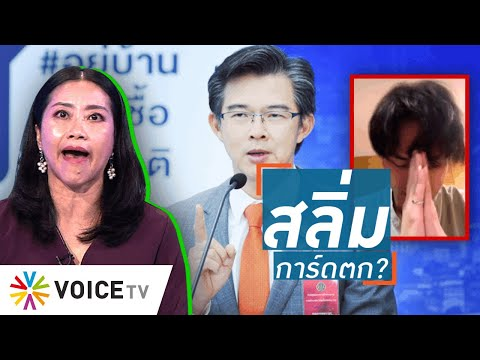

In [7]:
from IPython.display import YouTubeVideo

# Change the Youtube_ID with the link to your group's video.
YOUTUBE_ID = 'PIDzGDY-MpY'

YouTubeVideo(YOUTUBE_ID)

In [8]:
!rm -rf youtube.mp4
# download the youtube with the given ID
!youtube-dl -f 'bestvideo[ext=mp4]' --output "youtube.%(ext)s" https://www.youtube.com/watch?v=$YOUTUBE_ID
# cut the first 5 seconds
!ffmpeg -y -loglevel info -i youtube.mp4 -t 30 video.mp4
# clear any previous outputs.
!rm -rf processed
# detect poses on the these 10 seconds.
!./OpenFace/build/bin/FaceLandmarkVidMulti -f video.mp4 -out_dir processed
# convert the result into MP4
!ffmpeg -y -loglevel info -i processed/video.avi output.mp4

[youtube] PIDzGDY-MpY: Downloading webpage
[download] Destination: youtube.mp4
[download] 100% of 195.87MiB in 00:06
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis

In [9]:
def show_local_mp4_video(file_name, width=640, height=480):
  import io
  import base64
  from IPython.display import HTML
  video_encoded = base64.b64encode(io.open(file_name, 'rb').read())
  return HTML(data='''<video width="{0}" height="{1}" alt="test" controls>
                        <source src="data:video/mp4;base64,{2}" type="video/mp4" />
                      </video>'''.format(width, height, video_encoded.decode('ascii')))

show_local_mp4_video('output.mp4', width=960, height=720)

In [10]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import pandas as pd, seaborn as sns
sns.set_style('white')
import matplotlib.pyplot as plt 

# Load data
df = pd.read_csv('processed/video.csv')
# Remove empty spaces in column names.
df.columns = [col.replace(" ", "") for col in df.columns]
# Print few values of data.
print(f"Max number of frames {df.frame.max()}", f"\nTotal shape of dataframe {df.shape}")
df.head()

Max number of frames 750 
Total shape of dataframe (743, 714)


,frame,face_id,timestamp,confidence,success,gaze_0_x,gaze_0_y,gaze_0_z,gaze_1_x,gaze_1_y,gaze_1_z,gaze_angle_x,gaze_angle_y,eye_lmk_x_0,eye_lmk_x_1,eye_lmk_x_2,eye_lmk_x_3,eye_lmk_x_4,eye_lmk_x_5,eye_lmk_x_6,eye_lmk_x_7,eye_lmk_x_8,eye_lmk_x_9,eye_lmk_x_10,eye_lmk_x_11,eye_lmk_x_12,eye_lmk_x_13,eye_lmk_x_14,eye_lmk_x_15,eye_lmk_x_16,eye_lmk_x_17,eye_lmk_x_18,eye_lmk_x_19,eye_lmk_x_20,eye_lmk_x_21,eye_lmk_x_22,eye_lmk_x_23,eye_lmk_x_24,eye_lmk_x_25,eye_lmk_x_26,...,p_29,p_30,p_31,p_32,p_33,AU01_r,AU02_r,AU04_r,AU05_r,AU06_r,AU07_r,AU09_r,AU10_r,AU12_r,AU14_r,AU15_r,AU17_r,AU20_r,AU23_r,AU25_r,AU26_r,AU45_r,AU01_c,AU02_c,AU04_c,AU05_c,AU06_c,AU07_c,AU09_c,AU10_c,AU12_c,AU14_c,AU15_c,AU17_c,AU20_c,AU23_c,AU25_c,AU26_c,AU28_c,AU45_c
0,1,0,0.00,0.98,1,-0.080952,0.282465,-0.955856,-0.300165,0.234174,-0.924696,-0.200,0.268,1056.0,1059.5,1067.2,1074.6,1077.4,1074.5,1066.2,1058.7,1046.2,1050.3,1056.5,1065.0,1073.7,1080.0,1084.6,1078.5,1070.8,1062.9,1055.8,1050.1,1062.9,1066.7,1070.6,1072.5,1071.1,1067.3,1063.3,...,0.362,-0.274,0.228,-0.007,0.020,2.62,3.26,0.0,2.26,0.0,0.11,0.0,0.0,0.00,0.24,0.82,0.00,0.78,0.04,0.17,0.82,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0
1,2,0,0.04,0.98,1,-0.061151,0.293138,-0.954113,-0.250306,0.226926,-0.941197,-0.163,0.268,1050.3,1053.6,1061.3,1068.8,1071.7,1069.1,1060.8,1053.3,1040.8,1044.4,1050.2,1058.4,1067.2,1073.8,1078.7,1072.5,1064.7,1056.9,1049.8,1044.4,1057.7,1061.3,1065.0,1066.6,1065.2,1061.5,1057.9,...,0.450,-0.071,0.174,0.118,0.034,2.93,3.29,0.0,1.94,0.0,0.60,0.0,0.0,0.00,0.29,0.87,0.31,0.62,0.47,0.00,1.08,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0
2,3,0,0.08,0.98,1,-0.027673,0.294152,-0.955358,-0.264465,0.243136,-0.933243,-0.153,0.277,1045.3,1048.4,1055.9,1063.4,1066.6,1064.2,1056.0,1048.5,1034.9,1038.6,1044.6,1053.0,1061.8,1068.3,1073.0,1067.1,1059.3,1051.5,1044.4,1038.8,1052.7,1056.2,1059.8,1061.2,1059.7,1056.2,1052.7,...,0.433,-0.110,0.322,0.140,0.016,2.74,3.36,0.0,1.56,0.0,0.51,0.0,0.0,0.00,0.00,0.76,0.58,0.35,0.47,0.00,0.83,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0
3,4,0,0.12,0.98,1,-0.000736,0.297844,-0.954614,-0.217098,0.231581,-0.948282,-0.114,0.271,1040.6,1043.5,1050.9,1058.6,1062.0,1059.8,1051.7,1044.1,1029.3,1033.3,1039.6,1048.3,1057.2,1063.5,1068.2,1062.5,1054.9,1047.0,1039.8,1033.7,1048.1,1051.6,1055.1,1056.4,1054.8,1051.3,1047.9,...,0.398,-0.141,0.385,0.128,-0.050,2.80,3.33,0.0,1.43,0.0,0.33,0.0,0.0,0.03,0.01,0.87,0.78,0.20,0.56,0.00,0.59,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0
4,5,0,0.16,0.98,1,0.014673,0.297535,-0.954598,-0.202681,0.258317,-0.944559,-0.099,0.285,1036.1,1038.7,1046.1,1053.9,1057.6,1055.5,1047.5,1039.7,1024.6,1028.6,1034.9,1043.3,1052.3,1058.8,1063.7,1058.0,1050.5,1042.7,1035.3,1029.2,1043.7,1047.3,1050.7,1051.9,1050.3,1046.7,1043.2,...,0.365,-0.011,0.224,0.109,-0.071,2.64,3.41,0.0,2.25,0.0,1.34,0.0,0.0,0.32,0.00,0.58,0.00,0.00,0.00,0.59,1.07,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0


List of AU columns: Index(['AU01_r', 'AU02_r', 'AU04_r', 'AU05_r', 'AU06_r', 'AU07_r', 'AU09_r',
       'AU10_r', 'AU12_r', 'AU14_r', 'AU15_r', 'AU17_r', 'AU20_r', 'AU23_r',
       'AU25_r', 'AU26_r', 'AU45_r'],
      dtype='object')


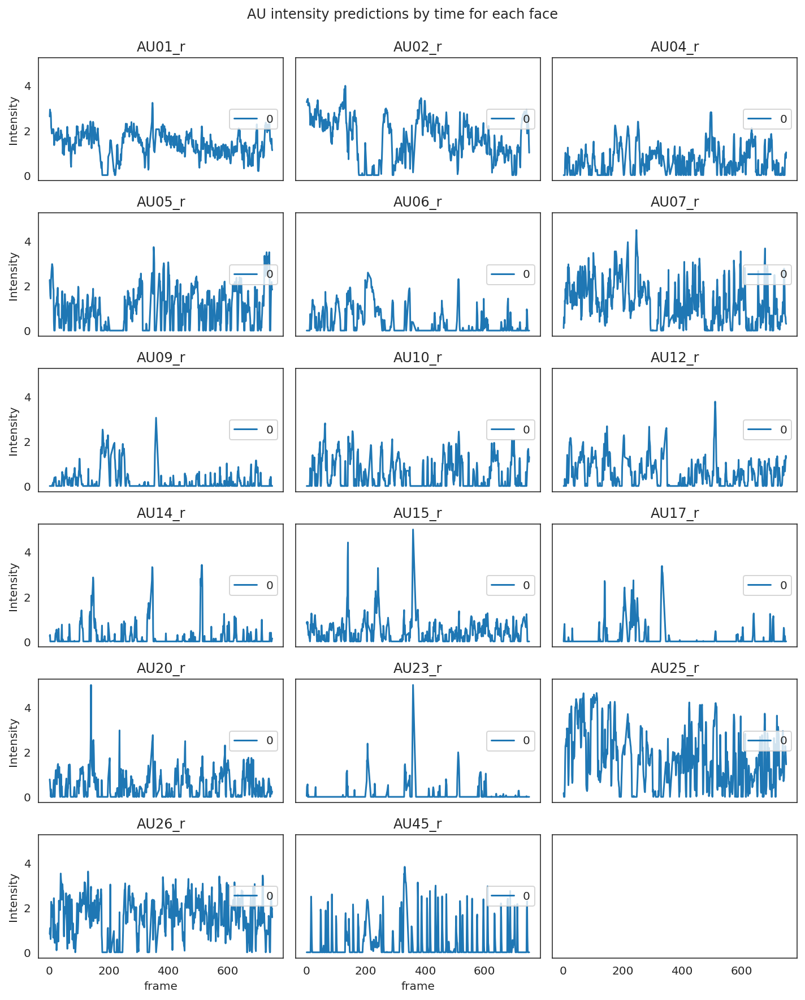

In [11]:
import re
# Threshold data by 80%
df_clean = df[df.confidence>=.80]
# Plot all Action Unit time series. 
au_regex_pat = re.compile(r'^AU[0-9]+_r$')
au_columns = df.columns[df.columns.str.contains(au_regex_pat)]
print("List of AU columns:", au_columns)
f,axes = plt.subplots(6, 3, figsize=(10,12), sharex=True, sharey=True)
axes = axes.flatten()
for au_ix, au_col in enumerate(au_columns):
    sns.lineplot(x='frame', y=au_col, hue='face_id', data=df_clean, ax=axes[au_ix])
    axes[au_ix].set(title=au_col, ylabel='Intensity')
    axes[au_ix].legend(loc=5)
plt.suptitle("AU intensity predictions by time for each face", y=1.02)
plt.tight_layout()